### Laboratorium 4 - zadania

In [37]:
import os

import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries, slic
from skimage.color import rgb2lab
from skimage.measure import regionprops

In [2]:
def plot_rgb_histogram(image):
    colors = ('r', 'g', 'b')
    plt.figure(figsize=(10, 5))
    
    for i, color in enumerate(colors):
        histogram, bin_edges = np.histogram(
            image[:, :, i], bins=256, range=(0, 256)
        )
        plt.plot(bin_edges[0:-1], histogram, color=color)
    
    plt.title("RGB Histogram")
    plt.xlabel("Color value")
    plt.ylabel("Pixels")
    plt.tight_layout()
    plt.xlim([0, 256])
    plt.show()

In [3]:
def plot_hsv_and_histograms(image):
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    
    channels = ['Hue', 'Saturation', 'Value']
    x_limits = [(0, 180), (0, 256), (0, 256)]  
    
    fig, axes = plt.subplots(3, 2, figsize=(15, 15))
    
    for i, channel in enumerate(channels):
        axes[i, 0].imshow(hsv_image[:, :, i], cmap='gray')
        axes[i, 0].set_title(f'{channel} Channel')
        axes[i, 0].axis('off')
        
        histogram, bin_edges = np.histogram(hsv_image[:, :, i], bins=256, range=x_limits[i])
        axes[i, 1].plot(bin_edges[0:-1], histogram, color='blue')
        axes[i, 1].set_title(f'{channel} Histogram')
        axes[i, 1].set_xlim(x_limits[i])
    
    plt.tight_layout()
    plt.show()


In [34]:
def superpixels(image, n_segments, sigma,channel_axis=-1):
    segments = slic(image, n_segments=n_segments, sigma=sigma, channel_axis=channel_axis)
    return mark_boundaries(image, segments, color=(1, 0, 0))

def search_superpixels(image, segments, sigmas, x_ratio=3, y_ratio=3, channel_axis=-1):
    fig, axs = plt.subplots(len(sigmas), len(segments), figsize=(x_ratio*len(sigmas), y_ratio*len(segments)), dpi=150)
    axs = axs.flatten()
    i = 0
    for sigma in sigmas:
        for n_segment in segments:
            boundaries = superpixels(image, n_segment, sigma, channel_axis)
            axs[i].imshow(boundaries, cmap='gray')
            axs[i].axis('off')
            axs[i].set_title(f"N:{n_segment},$\\sigma$:{sigma}")
            i += 1
    plt.tight_layout()
    plt.show()


#### Zadanie 1

Dane są obrazy `tabby` i `pills`. Wykonaj dla nich segmentację przy użyciu algorytmu SLIC. Celem jest uzyskanie **jednolitych**  superpikseli, a więc zawierających tylko fragmenty obiektów lub tylko tła (a nie jednego i drugiego naraz). Przeanalizuj zachowanie algorytmu dla różnej liczby superpikseli i parametru sigma.

Zwróć uwagę, że wynikiem działania scikitowej implementacji SLIC - [`skimage.segmentation.slic`](https://scikit-image.org/docs/stable/api/skimage.segmentation.html#skimage.segmentation.slic) - (podobnie jak wielu innych algorytmów klasyfikacyjnych) jest obraz typu `np.int64` przyporządkowujący każdemu pikselowi obrazu wejściowego indeks superpiksela. Takiej reprezentacji oczekuje też funkcja [`mark_boundaries`](https://scikit-image.org/docs/stable/api/skimage.segmentation.html#skimage.segmentation.mark_boundaries).

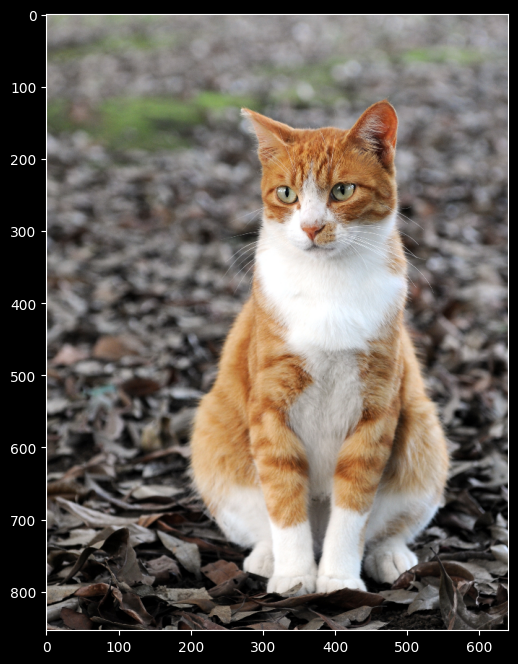

In [5]:
_ = cv2.imread('tabby.jpg')[..., ::-1]
tabby = cv2.resize(_, dsize=None, fx=0.3, fy=0.3)
plt.subplots(1,1,figsize=(8,8))[1].imshow(tabby);

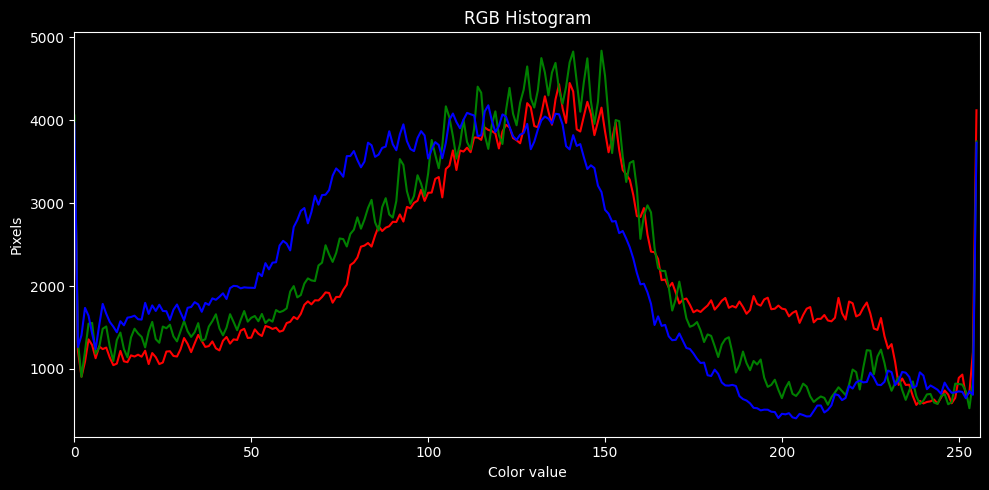

In [6]:
plot_rgb_histogram(tabby)


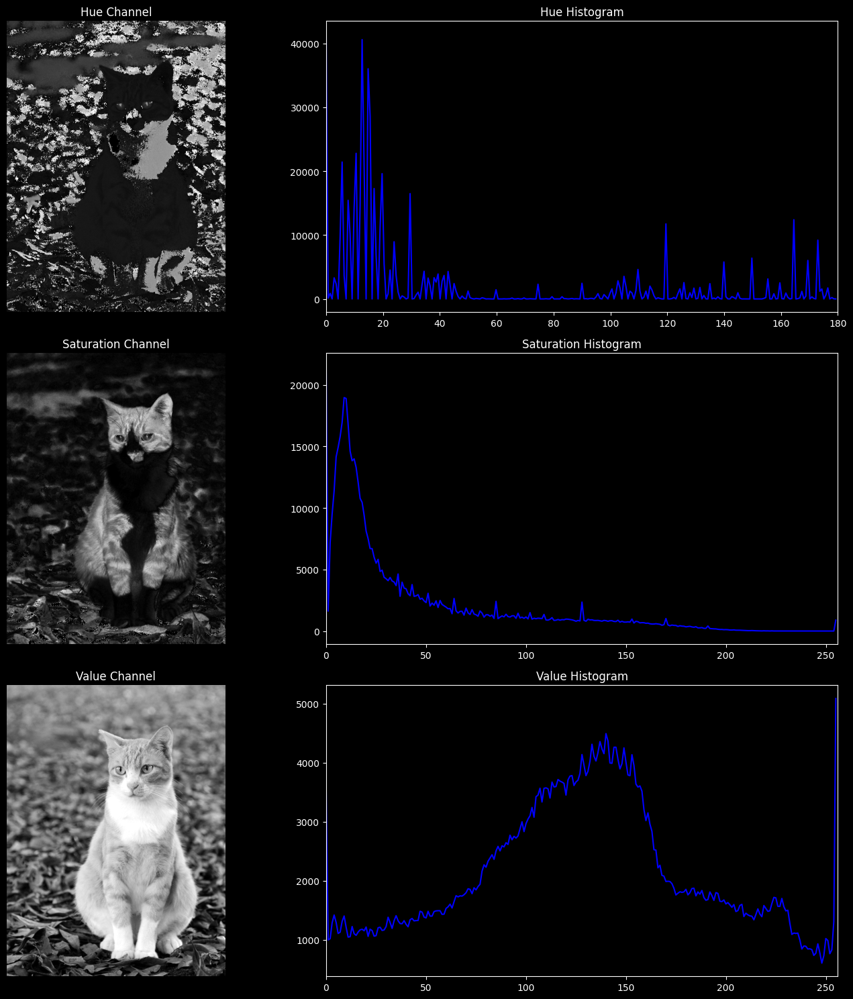

In [7]:
plot_hsv_and_histograms(tabby)

In [24]:
segments = [20, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]
sigmas = [0, 3, 5, 7, 10, 15, 20]

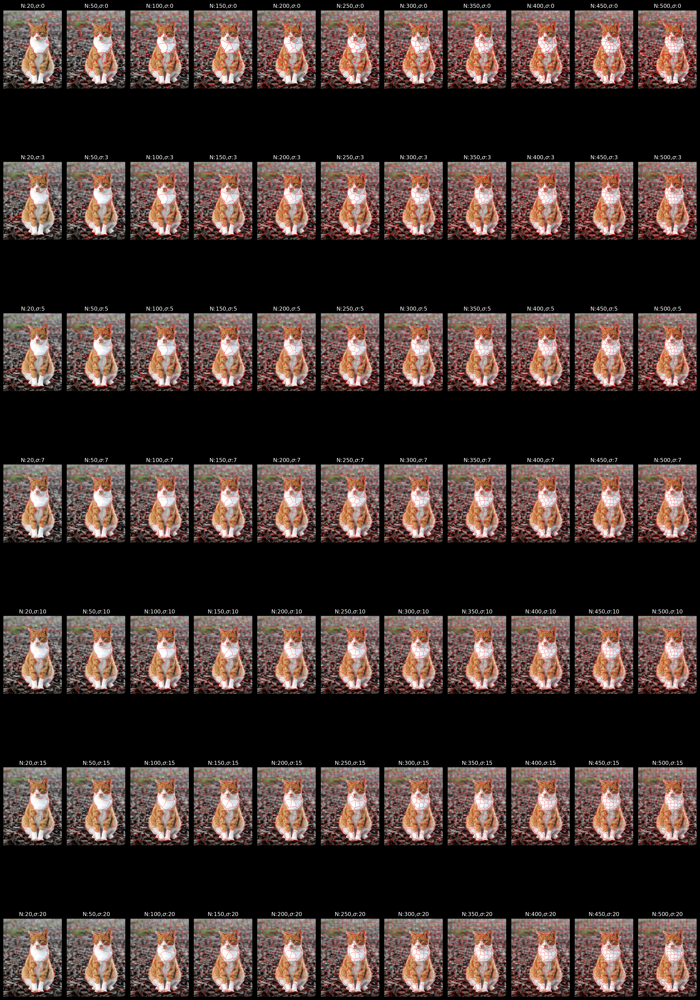

In [25]:
search_superpixels(image=tabby, segments=segments, sigmas=sigmas)

In [19]:
segments = [200, 300, 400]
sigmas = [5, 7, 9]

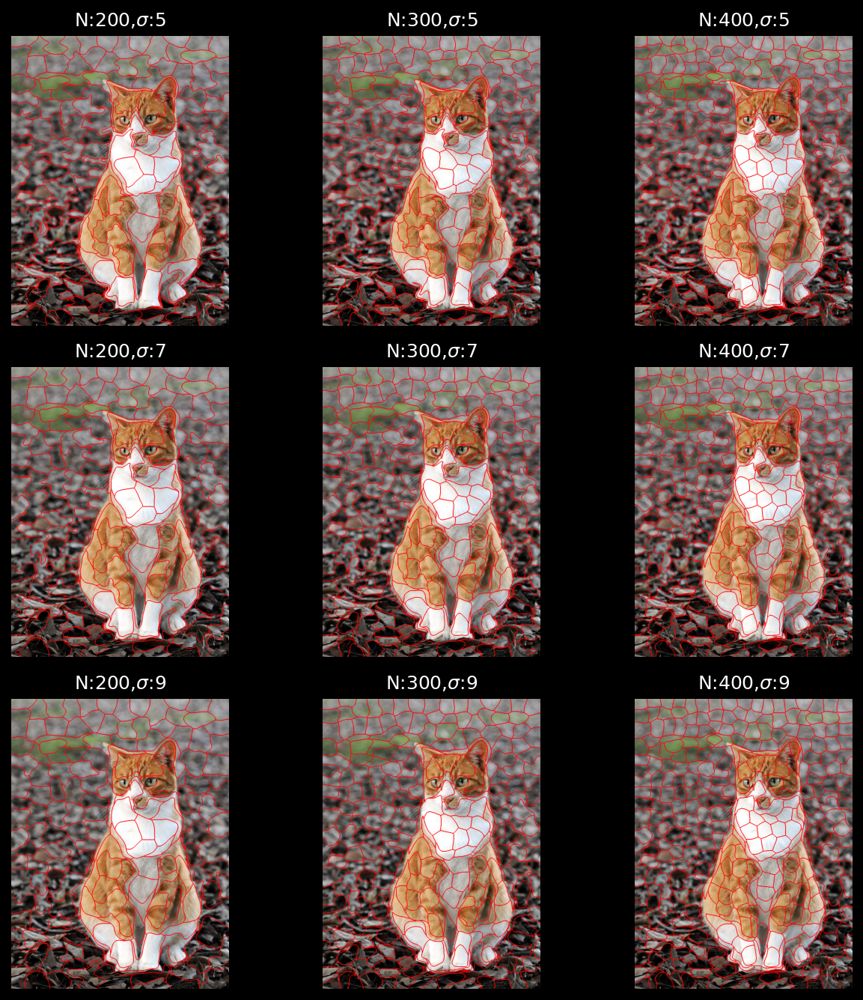

In [22]:
search_superpixels(image=tabby, segments=segments, sigmas=sigmas)

### Zbyt duża sigma sprawia, że obraz staje się zbyt mocno rozmyty przez co, superpiksele klas mieszają się ze sobą. To samo możemy zauważyć jeżeli liczba segmentów jest za mała. W przypadku zbyt małej sigmy obszary superpikseli stają się bardzo ostre, co daje możliwości na pojawienie się dodatkowych artefaktów. W przypadku zbyt dużej liczby segmentów obraz staje się niepotrzebnie zbyt złożony -- co będzie wpływać na długość dalszej analizy. 

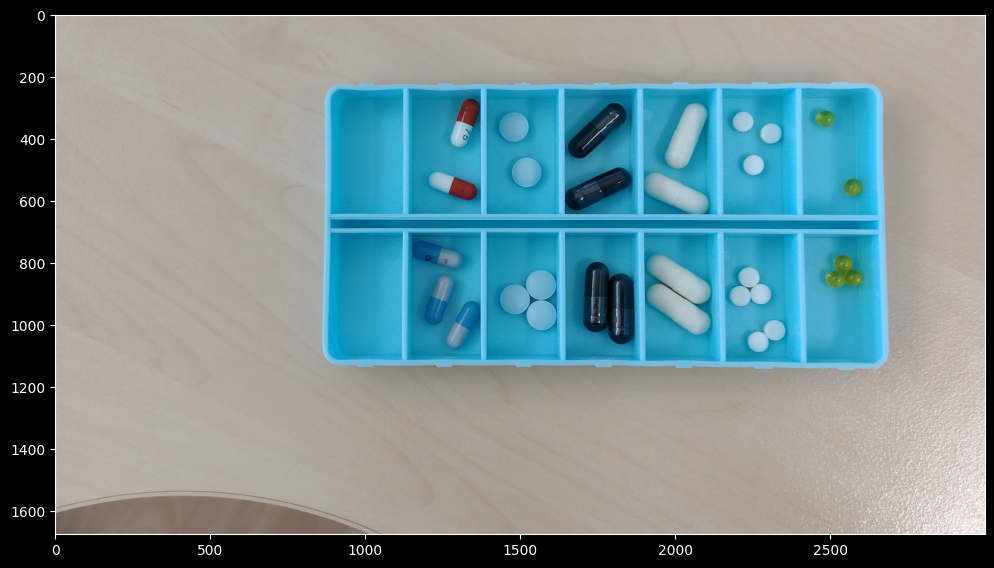

In [27]:
pills = cv2.imread('pills.png')[..., ::-1]
plt.subplots(1,1,figsize=(12,8))[1].imshow(pills);

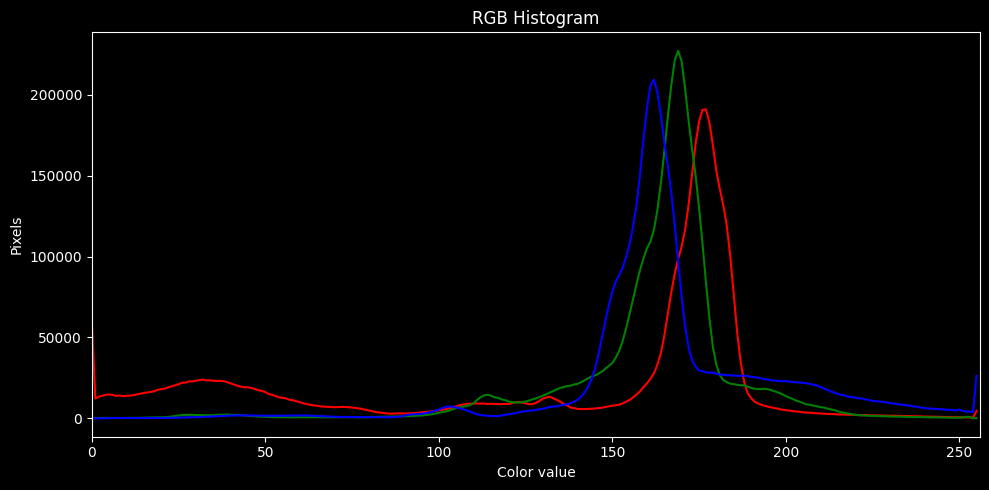

In [28]:
plot_rgb_histogram(pills)

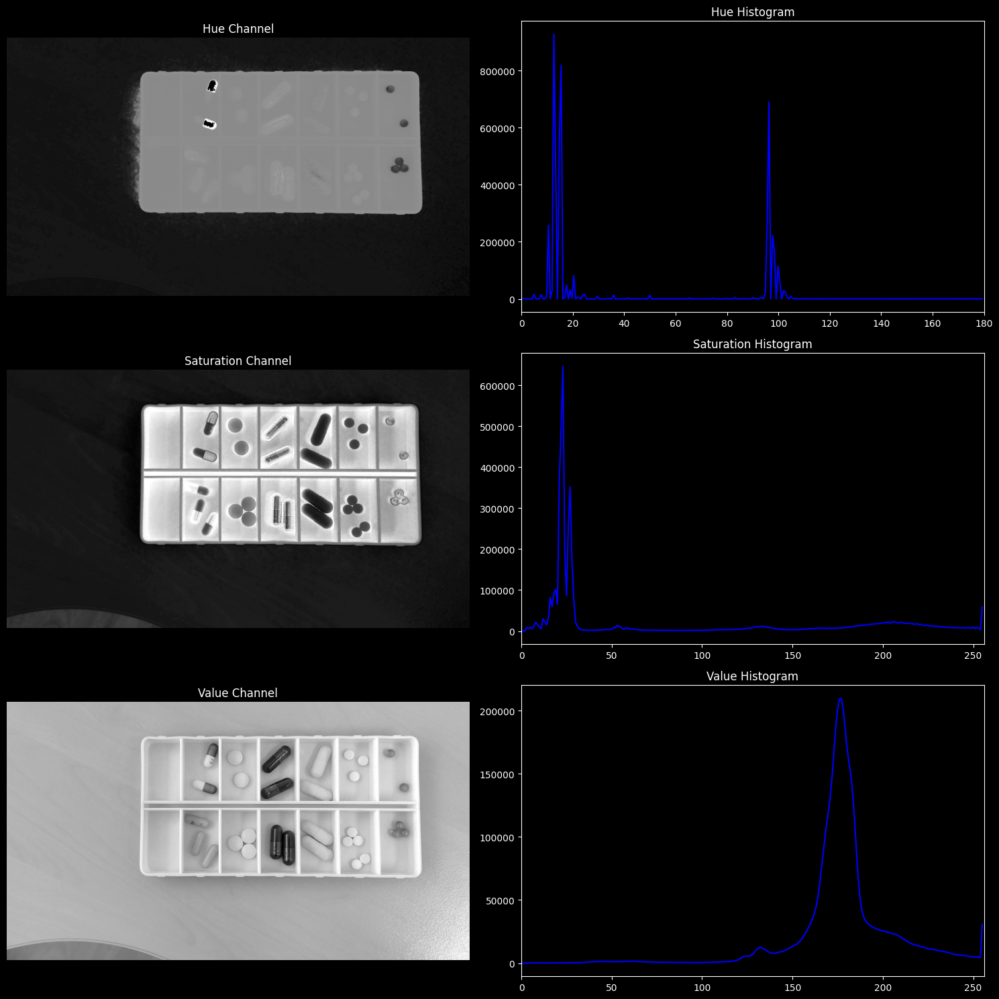

In [29]:
plot_hsv_and_histograms(pills)

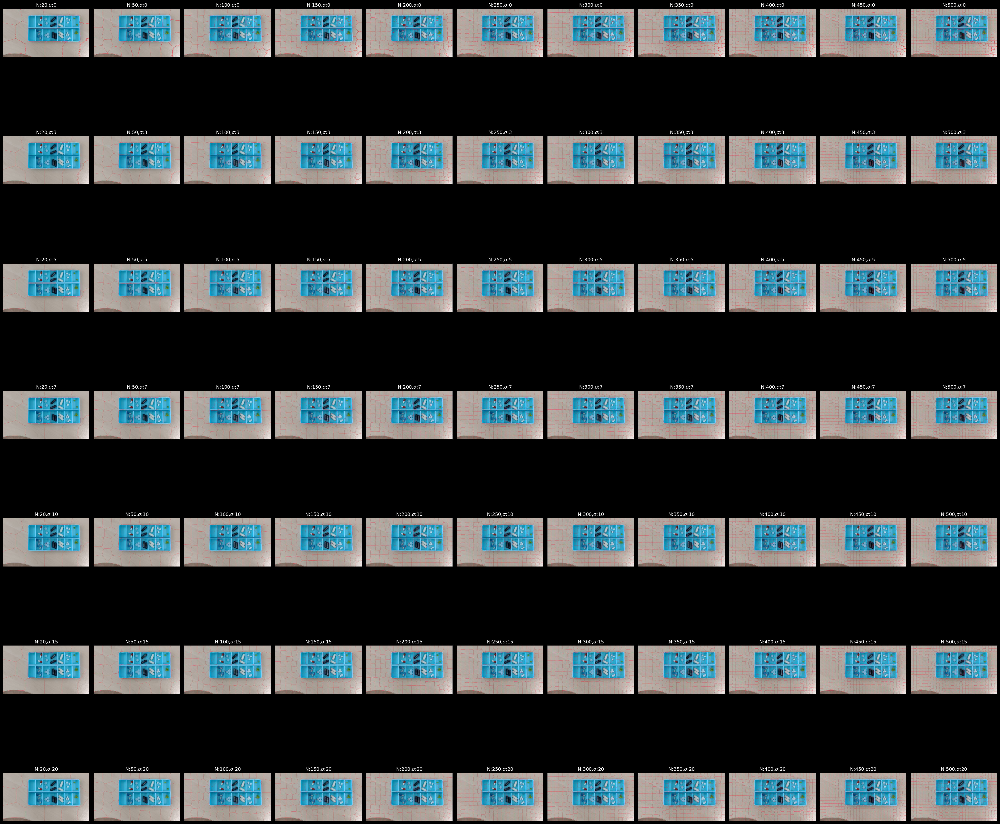

In [36]:
segments = [20, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500]
sigmas = [0, 3, 5, 7, 10, 15, 20]

search_superpixels(image=pills, segments=segments, sigmas=sigmas, x_ratio=5, y_ratio=3)

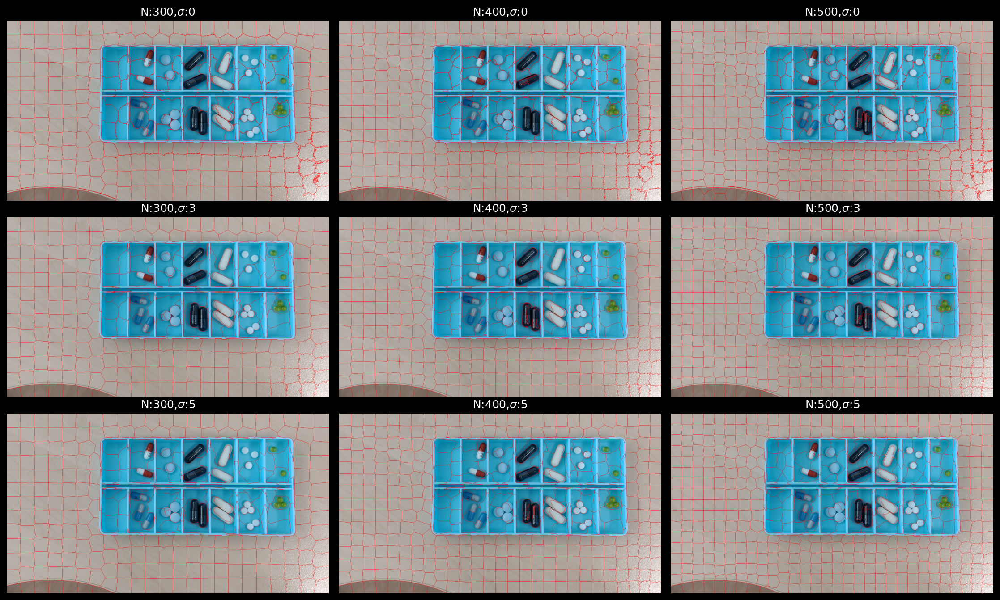

In [32]:
segments = [300, 400, 500]
sigmas = [0, 3, 5] 

search_superpixels(image=pills, segments=segments, sigmas=sigmas, x_ratio=5, y_ratio=3)

#### Zadanie 2

Dla obrazu `tabby` wykonaj post-processing segmentacji SLIC by uzyskać dwa jednorodne obszary: jeden zawierający wyłącznie kota, drugi zawierający wyłącznie tło.

Można to zadanie potraktować jako binaryzację na poziomie superpikseli i zrealizować je za pomocą progowania. 
Można też potraktować je jako klasteryzację superpikseli i wykorzystać np. [`cv2.kmeans`](https://docs.opencv.org/4.x/d5/d38/group__core__cluster.html#ga9a34dc06c6ec9460e90860f15bcd2f88).  
Niezależnie od wybranej ścieżki, konieczne będzie opisanie każdego z superpikseli za pomocą jakiejś *cechy* go opisującej (lub kilku cech). Najprostszymi cechami mogą być np. średnie wartości składowych barwy pikseli wchodzących w skład superpiksela.  
Do zastanowienia: jakie parametry SLICa wybrać jako podstawę w tym zadaniu?

Zaprezentuj wyniki albo za pomocą `mark_boundaries` albo wyświetlając maskę binarną.

---

NumPy pro-tip: aby uzyskać zbiór wszystkich pikseli obrazu o wartości np. 3 możesz użyć notacji: ```obraz==3```. Wynikiem jest macierz boolowska, której można używać jako selektor. Np. aby na obrazie `A` wyzerować wszystkie piksele, którym w obrazie `B` odpowiada wartość 5, możesz napisać:  
```A[B==5] = 0```  
Ten zapis jest **znacznie** szybszy niż manualne iterowanie po obrazach i sprawdzanie warunków if-ami.

---

Przykładowe użycie `cv2.kmeans` (więcej możesz poczytać np. [tutaj](https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_ml/py_kmeans/py_kmeans_opencv/py_kmeans_opencv.html)):
```python
c, labels, centers = cv2.kmeans(
    data=data,  # np.ndarray typu float o wymiarach NxK gdzie N to liczba sampli (u nas: superpikseli), K - liczba cech
    K=2,        # oczekiwana liczba klastrów
    bestLabels=None,
    criteria=(cv2.TERM_CRITERIA_EPS, 10, 1.0),  # przykładowe kryteria stopu
    attempts=1, # liczba powtórzeń algorytmu
    flags=cv2.KMEANS_RANDOM_CENTERS  # sposób inicjalizacji klastrów
)
```

Funkcja ta zwraca krotkę, której najważniejszym komponentem jest ten drugi (tu: `labels`), tj. macierz o wymiarach Nx1, zawierająca indeks klastra przypisanego i-temu samplowi.

In [34]:
# zacznij od przygotowania macierzy wejściowej (data) reprezentującej superpiksele jako punkty danych

In [65]:
def mean_hsv(image, segments):
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    superpixel_ids = np.unique(segments)
    features = []

    for superpixel_id in superpixel_ids:
      mask = segments == superpixel_id
      mean_hsv = np.mean(hsv_image[mask], axis=0)  
      features.append(mean_hsv)

    return np.array(features, dtype=np.float32), superpixel_ids

In [105]:
def mean_rgb(image, segments):
    superpixel_ids = np.unique(segments)
    features = []

    for superpixel_id in superpixel_ids:
      mask = segments == superpixel_id
      mean_hsv = np.mean(image[mask], axis=0)  
      features.append(mean_hsv)

    return np.array(features, dtype=np.float32), superpixel_ids

In [66]:
n_segments = 400
sigma = 5

tabby_segments = slic(tabby, n_segments=n_segments, sigma=sigma, )

In [75]:
features, superpixel_ids = mean_hsv(tabby, tabby_segments)
K = 2
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
_, labels, _ = cv2.kmeans(features, K, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

binary_mask = np.zeros(tabby_segments.shape, dtype=np.uint8)
for i, superpixel_id in enumerate(superpixel_ids):
  binary_mask[tabby_segments == superpixel_id] = (1-labels[i]) * 255



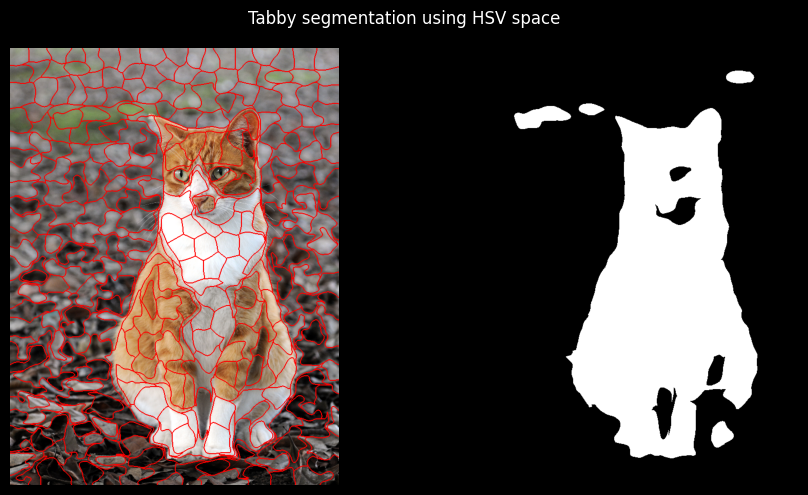

In [106]:
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
fig.suptitle('Tabby segmentation using HSV space')
ax[0].imshow(mark_boundaries(tabby, tabby_segments,color=(1, 0, 0)))
ax[1].imshow(binary_mask, cmap='gray')
ax[0].axis('off')
ax[1].axis('off')
plt.tight_layout()
plt.show()

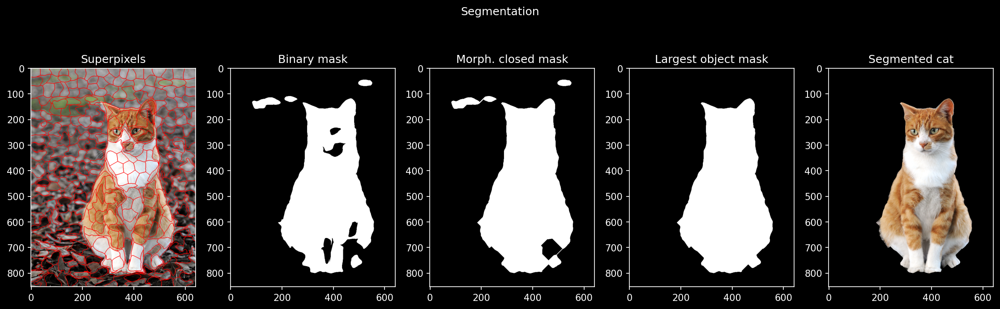

In [104]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
closed_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel, iterations=24)

contours, _ = cv2.findContours(closed_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# można usuwać wypukłość jakoś 
largest_contour = max(contours, key=cv2.contourArea)
largest_object_mask = np.zeros_like(closed_mask)
cv2.drawContours(largest_object_mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

fig, ax = plt.subplots(1, 5, figsize=(15, 5), dpi=150)

fig.suptitle('Segmentation')
ax[0].imshow(mark_boundaries(tabby, tabby_segments,color=(1, 0, 0)))
ax[0].set_title('Superpixels')
ax[1].imshow(binary_mask, cmap='gray')
ax[1].set_title('Binary mask')
ax[2].imshow(closed_mask, cmap='gray')
ax[2].set_title('Morph. closed mask')
ax[3].imshow(largest_object_mask, cmap='gray')
ax[3].set_title('Largest object mask')
ax[4].imshow(cv2.bitwise_and(tabby, tabby, mask=largest_object_mask))
ax[4].set_title('Segmented cat')


plt.tight_layout()
plt.show()

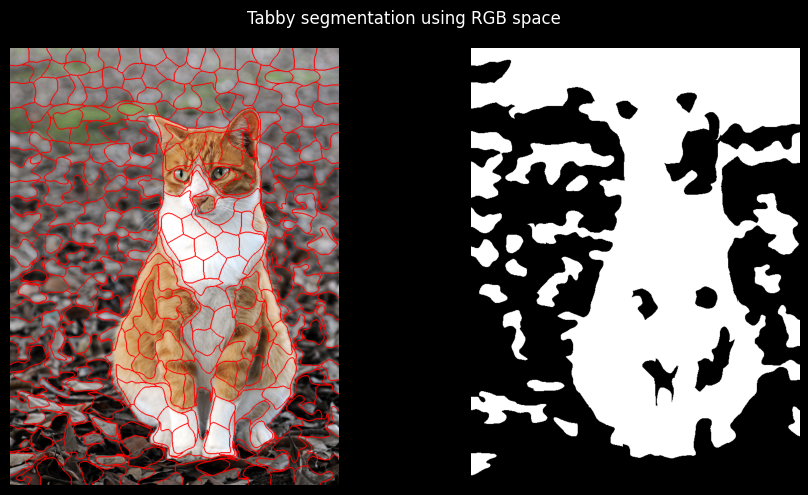

In [108]:
n_segments = 400
sigma = 5

tabby_segments = slic(tabby, n_segments=n_segments, sigma=sigma, )
features, superpixel_ids = mean_rgb(tabby, tabby_segments)
K = 2
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
_, labels, _ = cv2.kmeans(features, K, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

binary_mask = np.zeros(tabby_segments.shape, dtype=np.uint8)
for i, superpixel_id in enumerate(superpixel_ids):
  binary_mask[tabby_segments == superpixel_id] = (1-labels[i]) * 255

fig, ax = plt.subplots(1, 2, figsize=(10, 5))
fig.suptitle('Tabby segmentation using RGB space')
ax[0].imshow(mark_boundaries(tabby, tabby_segments,color=(1, 0, 0)))
ax[1].imshow(binary_mask, cmap='gray')
ax[0].axis('off')
ax[1].axis('off')
plt.tight_layout()
plt.show()